In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

def readFile(filename,w,v):
	f = open(filename, "r")
	i=0
	for line in f:
		if line[0]=="i":
			data = line.split()
			w[i]=int(data[1])
			for j in range(v.shape[1]):
				v[i,j]=int(data[2+j])
			i=i+1
		else:
			if line[0]=="W":
				data = line.split()	
				W=int(data[1])
	f.close()
	return W


def readPoints(filename,p):
	f = open(filename, "r")
	nbPND = 0
	for line in f:
		nbPND += 1
	YN = np.zeros((nbPND,p))
	f = open(filename, "r")
	i=0
	for line in f:
		data = line.split()
		for j in range(p):
			YN[i][j]=int(data[j])
		i=i+1
	f.close()
	return YN


In [3]:
w=np.zeros(200,dtype=int)
v=np.zeros((200,6),dtype=int)
filename = "data/2KP200-TA-0.dat"
W=readFile(filename,w,v)

#Génération de m solutions aléatoires
m=100

costs = {}
solutions = {}

for i in range(m):
	w_total = 0
	current_solution = set()
	current_cost =  np.zeros(v.shape[1])
	arr = np.arange(w.shape[0])
	np.random.shuffle(arr)
	for j in arr:
		if w_total + w[j] <= W:
			current_solution.add(j)
			next_item = v[j]
			w_total += w[j]
			for k in range(v.shape[1]):
				current_cost[k] += next_item[k]
	costs[i] = current_cost
	solutions[i] = current_solution

print(costs)
print(solutions)
print(w[np.array(list(solutions[0]))].sum())

{0: array([54650., 52246., 51474., 48253., 49840., 51267.]), 1: array([53878., 53633., 54951., 48720., 51354., 50566.]), 2: array([54845., 52965., 53812., 48299., 48141., 47767.]), 3: array([53937., 56281., 58433., 50810., 50230., 57550.]), 4: array([53584., 50815., 54419., 50916., 49246., 51712.]), 5: array([56066., 54407., 51190., 53768., 48136., 48643.]), 6: array([54005., 50189., 51472., 49800., 47464., 50338.]), 7: array([58266., 49672., 54524., 47715., 48867., 50282.]), 8: array([57332., 52640., 54556., 52887., 49467., 48762.]), 9: array([58177., 53735., 58604., 54434., 52179., 55589.]), 10: array([59290., 53890., 50636., 57922., 52352., 55992.]), 11: array([55720., 50535., 51477., 52378., 50416., 48202.]), 12: array([56849., 55358., 58197., 58204., 56482., 50074.]), 13: array([52661., 51531., 49607., 50503., 47514., 50144.]), 14: array([54795., 53269., 55052., 51910., 49417., 50922.]), 15: array([53702., 53909., 52493., 53881., 51577., 55422.]), 16: array([53553., 49384., 54177.

In [4]:
from pareto import *

#Une instance d'un dictionnaire de vecteurs de 6 coûts
dico = {2:np.array([1,2,3,4,2,3]),0:np.array([6,8,9,10,11,12]),1:np.array([4,5,1,4,2,3])}

#Une autre instance avec 10 vecteurs randoms de couts
dico2 = {i:np.random.randint(1,10,6) for i in range(10)}

print(pareto_front(dico))

print(dico2)
print(pareto_front(dico2))

{0: array([ 6,  8,  9, 10, 11, 12])}
{0: array([4, 8, 1, 3, 1, 2]), 1: array([1, 7, 3, 2, 3, 4]), 2: array([1, 9, 8, 3, 6, 6]), 3: array([8, 1, 6, 5, 6, 9]), 4: array([7, 6, 2, 5, 9, 6]), 5: array([9, 5, 2, 5, 4, 2]), 6: array([8, 1, 6, 7, 1, 9]), 7: array([4, 1, 7, 1, 1, 1]), 8: array([3, 5, 8, 7, 6, 2]), 9: array([9, 9, 5, 1, 6, 5])}
{0: array([4, 8, 1, 3, 1, 2]), 2: array([1, 9, 8, 3, 6, 6]), 3: array([8, 1, 6, 5, 6, 9]), 4: array([7, 6, 2, 5, 9, 6]), 5: array([9, 5, 2, 5, 4, 2]), 6: array([8, 1, 6, 7, 1, 9]), 7: array([4, 1, 7, 1, 1, 1]), 8: array([3, 5, 8, 7, 6, 2]), 9: array([9, 9, 5, 1, 6, 5])}


In [8]:
#Donne les voisins de la solution sol, dont la valeur de la solution est cost, pour la liste d'objet obj et leur poids weight
def voisinage(cost, sol, obj, weight, max_weight):
    inside = np.array(list(sol))
    outside = np.delete(np.array(list(range(len(obj)))), inside)

    w_sol = w[np.array(list(sol))].sum()
    voisinage = dict()
    voisinage_cost = dict()
    k = 0
    for i in inside:
        for j in outside:
            if w_sol - weight[i] + weight[j] <= max_weight:
                new_sol = sol.copy()
                new_sol.remove(i)
                new_sol.add(j)
                voisinage[k] = set(new_sol)
                voisinage_cost[k] = cost - obj[i] + obj[j]
                k+=1
    return voisinage_cost, voisinage

print(solutions[0])
c, s = voisinage(costs[0], solutions[0], v, w, W)
print(c)

{0, 2, 6, 8, 10, 11, 12, 13, 14, 16, 21, 22, 23, 25, 28, 29, 30, 31, 32, 33, 34, 35, 37, 43, 45, 49, 52, 53, 54, 56, 57, 59, 62, 63, 67, 68, 70, 71, 72, 78, 79, 82, 84, 85, 90, 95, 96, 97, 98, 99, 100, 103, 104, 107, 108, 109, 111, 114, 115, 124, 125, 127, 128, 130, 131, 132, 133, 134, 135, 136, 138, 143, 144, 146, 147, 150, 151, 152, 154, 155, 157, 160, 161, 162, 167, 168, 169, 172, 176, 177, 180, 182, 183, 186, 188, 190, 191, 192, 194, 195, 197, 199}
{0: array([54671., 51649., 50886., 47662., 49254., 51451.]), 1: array([54530., 51492., 50829., 48012., 49524., 50976.]), 2: array([53932., 52296., 50933., 48214., 49433., 51557.]), 3: array([54555., 52046., 50894., 47994., 49238., 51116.]), 4: array([54653., 52025., 50640., 47879., 50086., 51016.]), 5: array([54423., 51594., 50944., 47694., 49762., 50682.]), 6: array([54773., 51823., 51117., 47516., 50053., 51156.]), 7: array([54362., 51510., 50797., 47552., 49462., 51206.]), 8: array([54617., 52090., 51259., 47796., 49921., 50642.]), 9:

In [9]:
#Variante du voisinage, qui ne retourne pas les voisins qui ont été déjà visités
def voisinage_var(cost, sol, obj, weight, max_weight, visited):
    inside = np.array(list(sol))
    outside = np.delete(np.array(list(range(len(obj)))), inside)

    w_sol = w[np.array(list(sol))].sum()
    voisinage = dict()
    voisinage_cost = dict()
    k = 0
    for i in inside:
        for j in outside:
            if w_sol - weight[i] + weight[j] <= max_weight:
                new_sol = sol.copy()
                new_sol.remove(i)
                new_sol.add(j)
                if new_sol not in visited:
                    voisinage[k] = new_sol
                    voisinage_cost[k] = cost - obj[i] + obj[j]
                    visited.add(frozenset(new_sol))
                    k+=1
    return voisinage_cost, voisinage, visited


In [10]:
visited = set()
all_voisins = dict()
for k, val in costs.items():
    c, s, visited = voisinage_var(val, solutions[k], v, w, W, visited)
    all_voisins[k] = s

In [11]:
tree2 = NDTree(None, pareto_dom_func = pareto_dominance_maximisation)
print(tree2.root)
tree2.update_tree(costs[0], solutions[0])
print(tree2.root)
root = tree2.get_root()
tree2.delete_sub_tree(root)
print(tree2.root)
for i in range(len(c)):
    print(c[i])
    print(s[i])
    tree2.update_tree(c[i], s[i])
    print(tree2.root)
print(str(tree2.root))

None
{0: array([9, 1, 5, 9, 9, 1]), 7: array([2, 4, 5, 8, 6, 7]), 4: array([6, 1, 9, 9, 7, 4]), 2: array([6, 5, 9, 6, 9, 9]), 8: array([7, 1, 6, 6, 4, 2]), 3: array([5, 9, 5, 2, 9, 2]), 6: array([3, 7, 9, 5, 3, 1]), 5: array([6, 8, 4, 8, 6, 2])}

ideal:[54650. 52246. 51474. 48253. 49840. 51267.],nadir:[54650. 52246. 51474. 48253. 49840. 51267.]
	ideal:[9 5 9 9 9 9],nadir:[2 1 5 6 4 1]
	ideal:[6 9 9 8 9 2],nadir:[3 7 4 2 3 1]

None
[51580. 51900. 50151. 51118. 48608. 51623.]
frozenset({0, 2, 5, 6, 8, 13, 15, 16, 17, 18, 20, 21, 22, 23, 27, 30, 34, 37, 39, 40, 41, 42, 43, 44, 46, 50, 51, 52, 53, 57, 59, 61, 62, 63, 67, 70, 73, 74, 78, 79, 81, 82, 85, 86, 88, 90, 91, 92, 93, 95, 97, 98, 101, 102, 103, 105, 106, 107, 108, 111, 112, 115, 116, 118, 119, 120, 124, 125, 126, 127, 129, 131, 137, 139, 142, 144, 145, 146, 147, 150, 152, 153, 154, 156, 157, 161, 165, 168, 169, 171, 173, 175, 176, 177, 178, 183, 186, 187, 189, 190, 191, 195})
{1: array([51580., 51900., 50151., 51118., 48608., 51623

KeyboardInterrupt: 

In [9]:
t1 = frozenset(set((1,2,3)))
t2 = frozenset(set((3,2,1)))
visited = set()
visited.add(t1)
print(visited)
if set((3,2,1)) in visited:
    print("t1 in visited")

{frozenset({1, 2, 3})}
t1 in visited


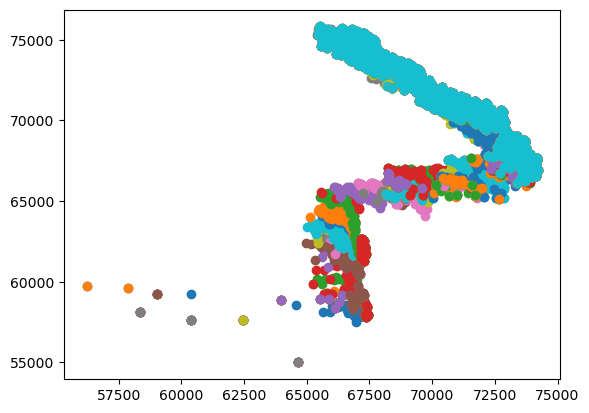

({6016: array([73596., 66960., 68023.]),
  6257: array([73484., 67128., 68177.]),
  6312: array([73365., 67221., 68230.]),
  6313: array([73431., 67190., 68261.]),
  6074: array([73550., 66466., 68228.]),
  5995: array([73689., 66246., 68177.]),
  5895: array([72687., 66769., 68419.]),
  6195: array([72578., 67864., 68309.]),
  6069: array([72870., 67127., 68369.]),
  6238: array([73043., 67083., 68331.]),
  6239: array([73109., 67052., 68362.]),
  6190: array([72990., 67316., 68348.]),
  6333: array([73299., 67320., 68278.]),
  6347: array([73163., 67272., 68310.]),
  5902: array([73367., 66108., 68278.]),
  6054: array([74204., 66943., 67687.]),
  6089: array([74053., 66922., 67848.]),
  6150: array([73919., 66729., 68034.]),
  6188: array([73921., 66856., 68025.]),
  6058: array([74142., 66532., 67913.]),
  6057: array([74076., 66563., 67882.]),
  6094: array([73991., 66511., 68074.]),
  6192: array([73604., 66686., 68176.]),
  6093: array([73925., 66542., 68043.]),
  6155: array([7

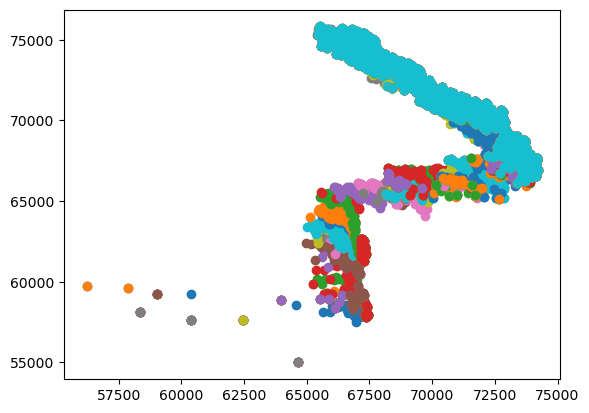

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from ndtree import *
from pareto import *
from func import *
from voisinage import *
from paretolocalsearch import *

w=np.zeros(200,dtype=int)
v=np.zeros((200,6),dtype=int)
filename = "data/2KP200-TA-0.dat"
W=readFile(filename,w,v)

#Reshape v to take only first two columns
v = v[:,:3]

#Génération de m solutions aléatoires
m=2000

costs = {}
solutions = {}

for i in range(m):
	w_total = 0
	current_solution = set()
	current_cost =  np.zeros(v.shape[1])
	arr = np.arange(w.shape[0])
	np.random.shuffle(arr)
	for j in arr:
		if w_total + w[j] <= W:
			current_solution.add(j)
			next_item = v[j]
			w_total += w[j]
			for k in range(v.shape[1]):
				current_cost[k] += next_item[k]
	costs[i] = current_cost
	solutions[i] = current_solution

couts, sols = PLS(costs, solutions, v, w, W)

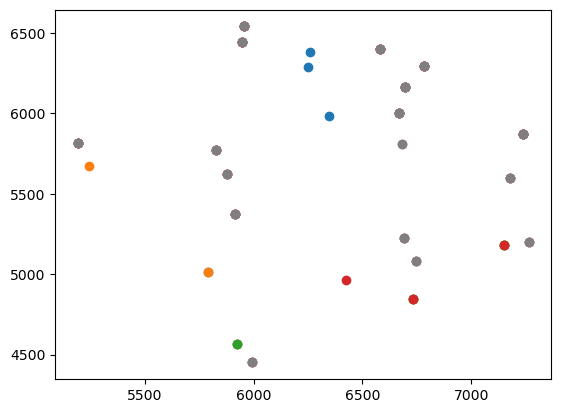

({27: array([6782., 6293., 6337.]),
  35: array([6697., 6164., 6643.]),
  45: array([5954., 6541., 7102.]),
  51: array([6580., 6400., 7651.]),
  28: array([7240., 5871., 7033.]),
  47: array([6666., 6002., 7593.]),
  61: array([7178., 5596., 7547.]),
  63: array([7264., 5198., 7489.]),
  65: array([6680., 5813., 7360.]),
  43: array([5945., 6447., 7583.]),
  50: array([5192., 5818., 7939.]),
  52: array([5913., 5373., 7949.]),
  54: array([5827., 5771., 8007.]),
  55: array([5880., 5626., 7894.]),
  60: array([5992., 4451., 8172.]),
  62: array([6692., 5225., 7929.]),
  64: array([6745., 5080., 7816.])},
 {27: {0, 1, 3, 4, 5, 7, 10, 11, 13, 17, 18, 19},
  35: {0, 2, 3, 4, 5, 7, 8, 10, 12, 13, 17, 18},
  45: {0, 1, 3, 4, 5, 7, 8, 10, 12, 13, 18},
  51: {0, 1, 3, 4, 5, 7, 8, 10, 13, 15, 18},
  28: {0, 3, 4, 5, 7, 8, 11, 13, 14, 15, 17, 18},
  47: {0, 3, 4, 5, 7, 8, 10, 13, 14, 15, 18},
  61: {0, 1, 3, 4, 5, 7, 8, 10, 13, 15, 17},
  63: {0, 3, 4, 5, 7, 8, 10, 13, 14, 15, 17},
  65: {0, 1

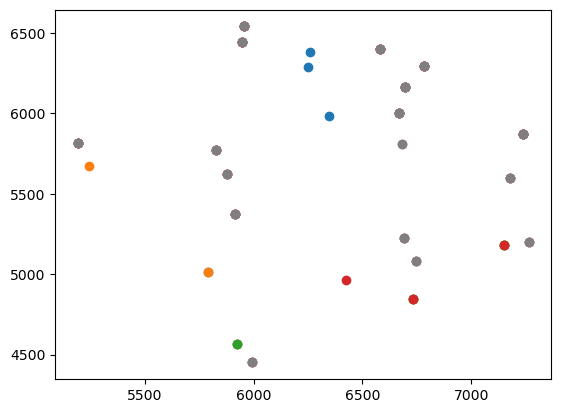

In [8]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from ndtree import *
from pareto import *
from func import *
from voisinage import *
from paretolocalsearch import *

w=np.zeros(200,dtype=int)
v=np.zeros((200,6),dtype=int)
filename = "data/2KP200-TA-0.dat"
W=readFile(filename,w,v)

#Génération de m solutions aléatoires
m=1000

N_OBJETS = 20
N_OBJECTIFS = 3

#Reshape v and w to only take first three objectives and first 20 items
v = v[:N_OBJETS]
v = v[:,:N_OBJECTIFS]
w = w[:N_OBJETS]

#W equals the sum of the weights divided by 2
W = int(w.sum()/2)

costs = {}
solutions = {}

for i in range(m):
	w_total = 0
	current_solution = set()
	current_cost =  np.zeros(v.shape[1])
	arr = np.arange(w.shape[0])
	np.random.shuffle(arr)
	for j in arr:
		if w_total + w[j] <= W:
			current_solution.add(j)
			next_item = v[j]
			w_total += w[j]
			for k in range(v.shape[1]):
				current_cost[k] += next_item[k]
	costs[i] = current_cost
	solutions[i] = current_solution

pls = PLS(costs, solutions, v, w, W)

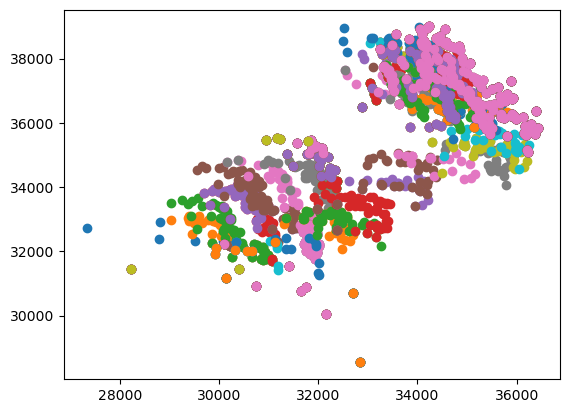

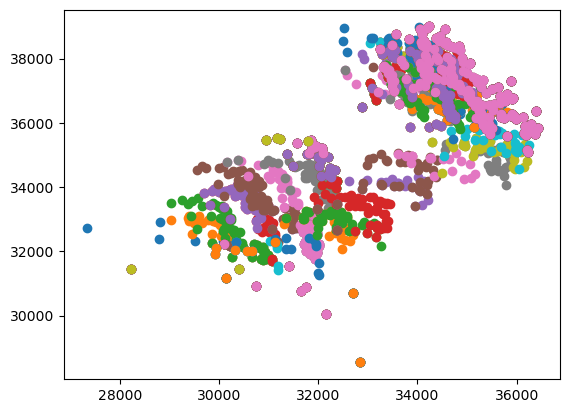

In [39]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from ndtree import *
from pareto import *
from func import *
from voisinage import *
from paretolocalsearch import *
from gurobi import *

w=np.zeros(200,dtype=int)
v=np.zeros((200,6),dtype=int)
filename = "data/2KP200-TA-0.dat"
W=readFile(filename,w,v)

#Génération de m solutions aléatoires
m=1000

N_OBJETS = 100
N_CRITERES = 3

#Reshape v and w to only take first three objectives and first 20 items
v = v[:N_OBJETS]
v = v[:,:N_CRITERES]
w = w[:N_OBJETS]

#W equals the sum of the weights divided by 2
W = int(w.sum()/2)

costs = {}
solutions = {}

for i in range(m):
	w_total = 0
	current_solution = set()
	current_cost =  np.zeros(v.shape[1])
	arr = np.arange(w.shape[0])
	np.random.shuffle(arr)
	for j in arr:
		if w_total + w[j] <= W:
			current_solution.add(j)
			next_item = v[j]
			w_total += w[j]
			for k in range(v.shape[1]):
				current_cost[k] += next_item[k]
	costs[i] = current_cost
	solutions[i] = current_solution

pls = PLS(costs, solutions, v, w, W)

In [46]:
id = np.array(list(pls[0].keys()))
X = np.array(list(pls[0].values()))
w = np.array(list(pls[1].values()))

agr_func = "WS" #Weighted sum

dm = DM(N_CRITERES, agr_func)
rbe = RBE(N_CRITERES, agr_func, X, True)

In [47]:
print(rbe.init_MR)
print(dm.weights)
print(rbe.MMR(X))

4943.0
[0.34006139 0.37233991 0.2875987 ]
0.2901072223346146


In [49]:
print(rbe.CSS_ask_query(X, dm))
print(rbe.pairs)

0.11073580590888023
[[array([34227., 38997., 34718.]), array([35007., 37563., 35575.])], [array([34049., 38904., 35098.]), array([35893., 37313., 32456.])]]
